# Colorizing the Prokudin-Gorskii Photo Collection

#### Student no : 21827866
#### Student name : Özhan Taşdemir

Imports

In [1]:
import numpy as np
import cv2
import os
import math
from PIL import Image, ImageFilter, ImageOps
import skimage as sk

Loading images

In [2]:
def load_images(folder):
    images = []
    for filename in os.listdir(folder):
        img = cv2.imread(os.path.join(folder,filename),cv2.IMREAD_GRAYSCALE)
        if img is not None:
            images.append(img)
    return images

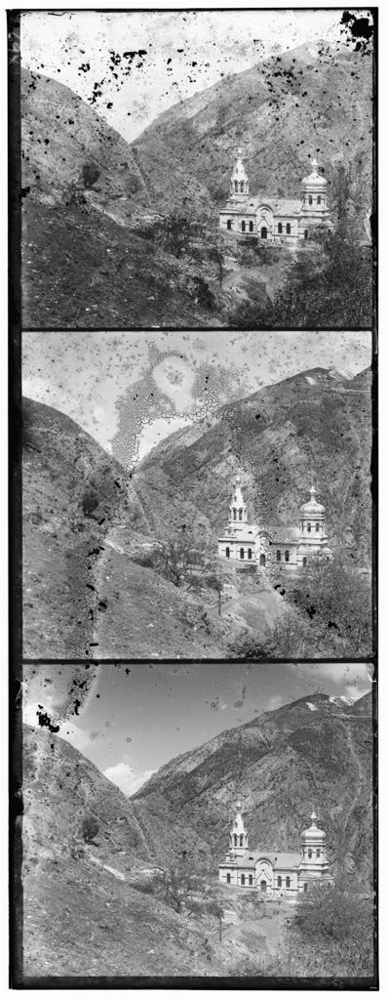

In [3]:
images = load_images("data")

img = Image.fromarray(images[0])
display(img)

Images are recorded three exposures of every scene onto a glass plate using a red, a green, and a blue filter. Now we can split images into three parts and we can create RGB images

In [4]:
def split_image(img): #split images to blue, green and red channels
        height = int(np.floor(img.shape[0] / 3.0))
        blue = img[:height]
        green = img[height: 2*height]
        red = img[2*height: 3*height]
        return np.array([red, green, blue])

In [5]:
rgb_images = []

In [6]:
for i in images:
    new_img = split_image(i)
    new_img = np.transpose(new_img, (1, 2, 0))
    rgb_images.append(new_img)

In [7]:
rgb_images[0].shape

(341, 398, 3)

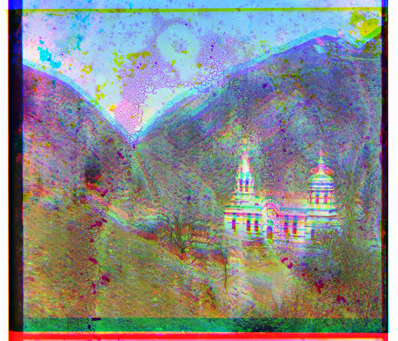

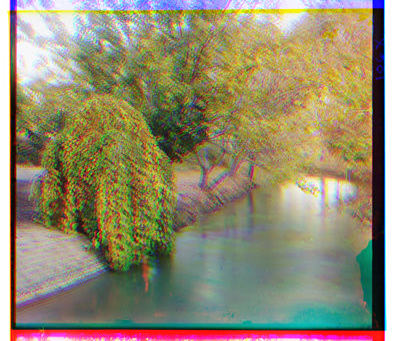

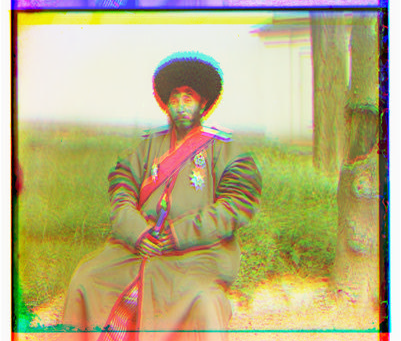

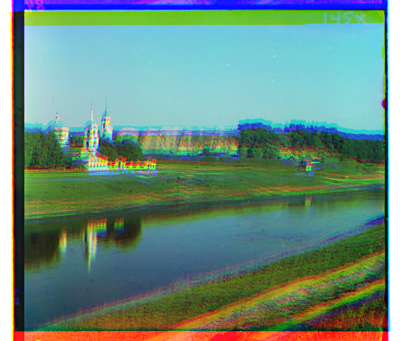

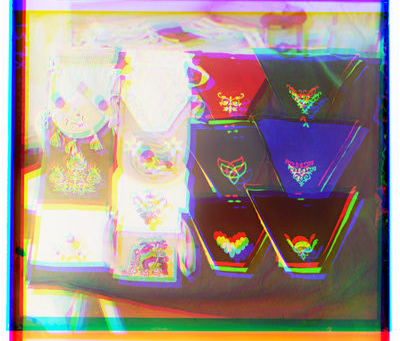

...

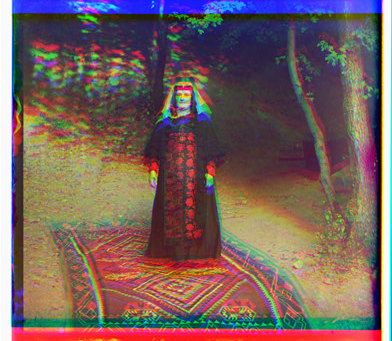

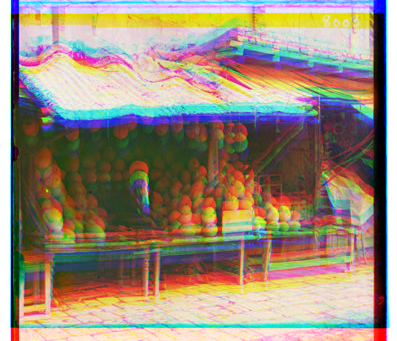

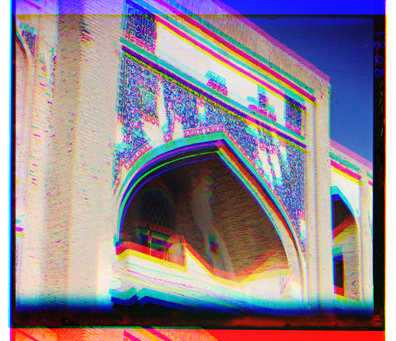

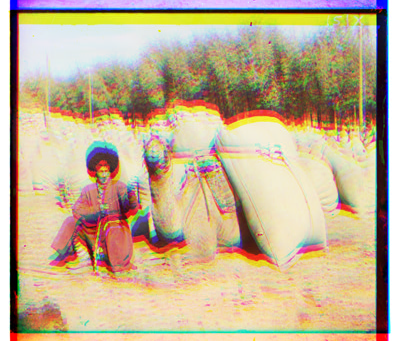

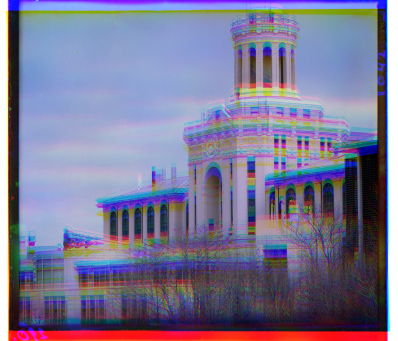

In [8]:
for i in rgb_images:
    img = Image.fromarray(i, 'RGB')
    #img.save('my.jpg')
    #img.show()
    display(img)

As you can see channels are not correctly aligned. Also frames has a extra black border. We can crop the borders and get rid of black parts. Also cropping black parts helps us to perform better channel alignment

In [9]:
def crop(img):
    # Crops 10% off the borders of the image

    height, width = img.shape
    new_height, new_width = int(height/1.11), int(width/1.11)
    return img[height-new_height:new_height, width-new_width:new_width]

In [10]:
cropped_images = []

for img in rgb_images:
    cropped_images.append(np.array([crop(img[:,:,0]),crop(img[:,:,1]),crop(img[:,:,2])]))

In [11]:
"""
#uncomment to display cropped images
for i in cropped_images:
    new_img = np.transpose(i, (1, 2, 0))
    img = Image.fromarray(new_img, 'RGB')
    
    display(img)
"""

"\n#uncomment to display cropped images\nfor i in cropped_images:\n    new_img = np.transpose(i, (1, 2, 0))\n    img = Image.fromarray(new_img, 'RGB')\n    \n    display(img)\n"

## Alignment
I've used normalized cross-correlation for alignment. NCC normalizes the image being shifted, and then takes the inner product of that image and the one it is being compared to as a vector. The larger this value, the closer the two images are, and thus, the better the match.

In [12]:
def ssd(a, b):
    #sum of square differences: sum(sum((a-b).^2))
    return (((a-b)**2).sum()).sum()

In [13]:
def ncc(a, b):
    #normalized cross-correlation: (a./||a|| dot b./||b||)
    return ((a/np.linalg.norm(a)) * (b/np.linalg.norm(b))).ravel().sum()

In [14]:
def find_displacement(img1, img2, bound, radius):
    #search and find best displacement
    best_score = -1
    for column in range(-radius + bound[0], radius + bound[0] ):
        for row in range(-radius + bound[1], radius + bound[1]):
            #print(np.shape(img2))
            img_displacement_score = ncc(img1, np.roll(np.roll(img2, column, axis = 0), row, axis = 1))
            if (img_displacement_score > best_score): 
                best_score = img_displacement_score
                img_displacement = [column, row]
    return img_displacement

In [15]:
def align(img, displacement):
    #align images using displacement vector
    aligned_img = np.roll(np.roll(img, displacement[0], axis = 0), displacement[1], axis = 1)
    return aligned_img

In [16]:
def naive_align(img1, img2, radius):
    bound = [radius, radius]
    displacement = find_displacement(img1, img2, bound, radius)
    return displacement

In [17]:
def stack_images(red_img, green_img, blue_img):
    #create rgb image
    color_img = np.dstack([red_img, green_img, blue_img])
    return color_img

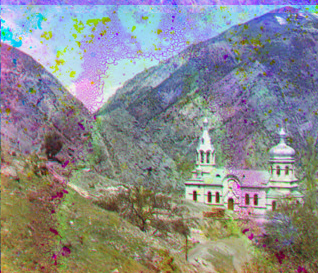

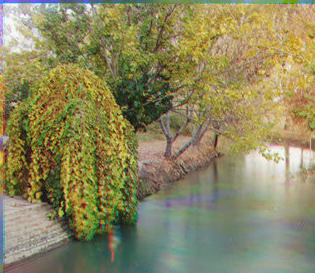

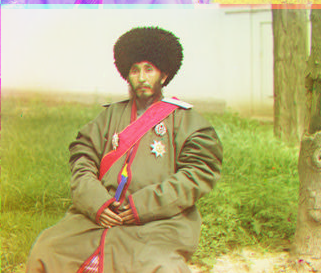

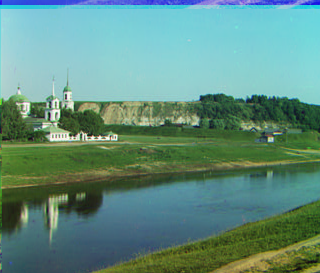

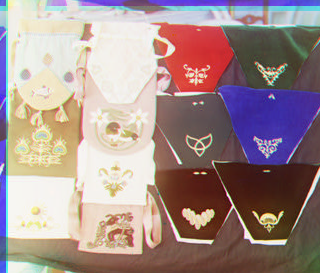

...

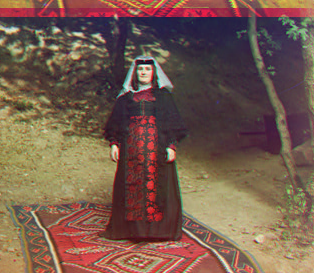

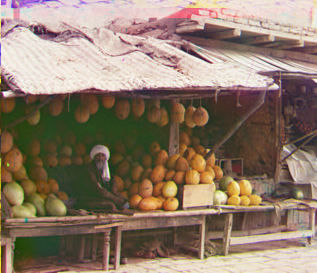

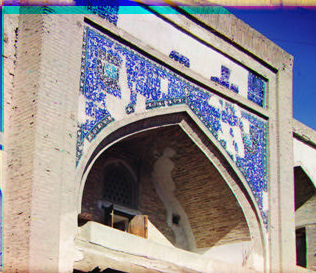

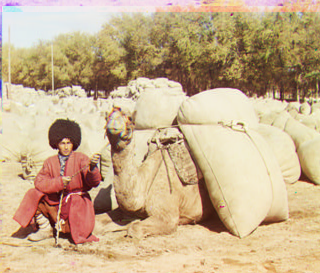

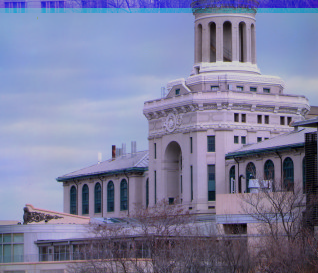

In [18]:
search_radius = 20

for img in cropped_images:
    img = np.transpose(img, (1, 2, 0))

    #color alignment
    displacement_green = naive_align(img[:,:,2],img[:,:,1], search_radius)
    aligned_green = align(img[:,:,1], displacement_green)
    displacement_red = naive_align(img[:,:,2], img[:,:,0], search_radius)
    aligned_red = align(img[:,:,0], displacement_red)

    #create rgb image
    color_img = stack_images(aligned_red, aligned_green, img[:,:,2])

    #new_img = np.transpose(color_img, (1, 2, 0))
    img2 = Image.fromarray(color_img, 'RGB')
    
    display(img2)

Now most of the photos are correctly aligned. But we can clearly see photo of the Emir(7th photo) is not aligned correctly. Comparison in colour intenstities has its limitations, and does not work in some cases. Edge detection does a comparison between the changes in intensities instead. There are many approaches to edge detection such as Sobel edge detection and Canny edge detection.

In [19]:
def get_edges(A):
    return sk.feature.canny(A, 3)

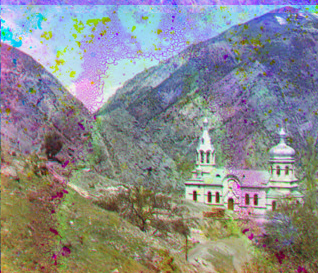

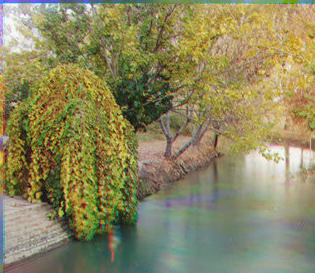

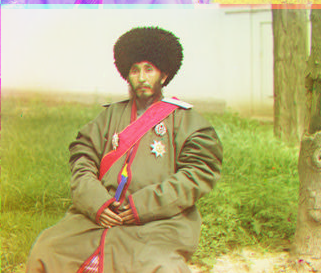

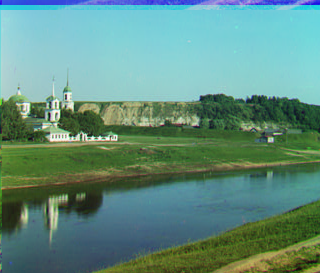

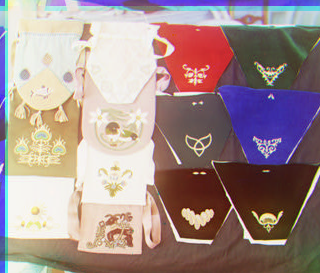

...

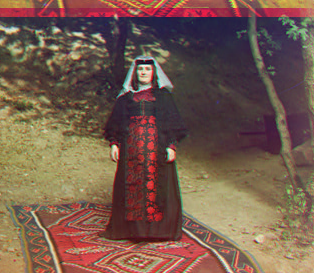

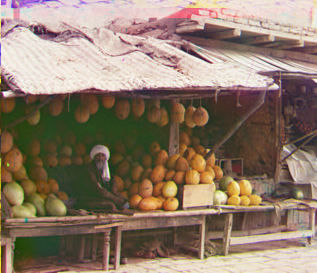

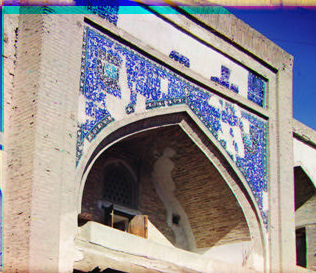

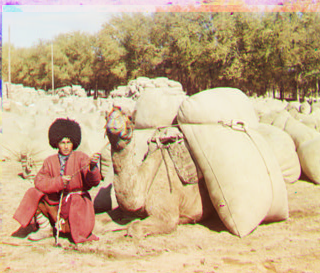

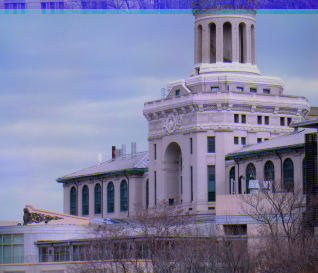

In [20]:
edge_aligned_images = []

for img in cropped_images:
    img = np.transpose(img, (1, 2, 0))
    
    r_edges = get_edges(img[:,:,0])
    g_edges = get_edges(img[:,:,1])
    b_edges = get_edges(img[:,:,2])
    
    green_displacement = naive_align(b_edges, g_edges,20)
    align_green = align(img[:,:,1], green_displacement)

    red_displacement = naive_align(b_edges, r_edges,20)
    align_red = align(img[:,:,0], red_displacement)


    color_img = stack_images(align_red, align_green, img[:,:,2])
    
    edge_aligned_images.append(np.array(color_img))
    
    img2 = Image.fromarray(color_img, 'RGB')
    
    #gamma(color_img,0.7)
    
    
    #img3 = ImageOps.autocontrast(img2, mask = None)
    #img4 = ImageOps.equalize(img2, mask = None)
    
    #display(img3)
    #display(img4)

    display(img2)

With edge detection photo of the Emir(7th photo) correctly alignned. Also some of the photoes has a small improvements in terms of alignment.

#### Notes on photos
Photo 1: Looks not great due burns on film. Some improvement can made using deep learning techniques


Photo 3: Colors are not vivid


Photo 5: Left side is super bright


Photo 6: Needs constransting


Photo 15: Colors looks cold


Photo 26: Some areas so dark


Photo 29: Colors looks cold

## Enhancements
Some photos need gamma and constrast correction. I also provided histogram equalization function

In [21]:
def gamma(img, value):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    mean = np.mean(gray)
    gamma = math.log(value*255)/math.log(mean)

    #gamma correction
    img_gamma = np.power(img, gamma).clip(0,255).astype(np.uint8)
    
    img2 = Image.fromarray(img_gamma, 'RGB')
    display(img2)

def autocontrast(img):
    
    img_contrast = Image.fromarray(img, 'RGB')
    img_contrast = ImageOps.autocontrast(img_contrast, mask = None)
    

    display(img_contrast)
 
def equalize(img):
    
    img_equalize = Image.fromarray(img, 'RGB')
    img_equalize = ImageOps.equalize(img_equalize, mask = None)
    

    display(img_equalize)

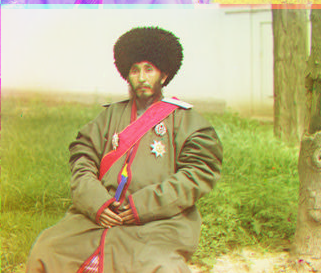

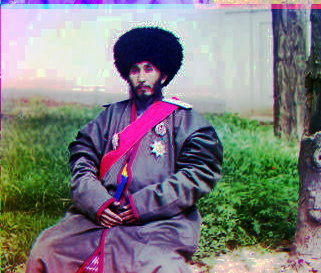

In [22]:
#image 3
img_02 = Image.fromarray(edge_aligned_images[2], 'RGB')
display(img_02)
equalize(edge_aligned_images[2])

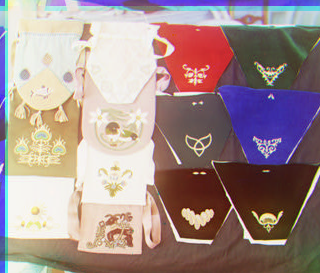

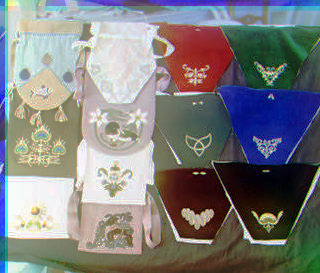

In [23]:
#image 5
img_05 = Image.fromarray(edge_aligned_images[4], 'RGB')
display(img_05)
equalize(edge_aligned_images[4])

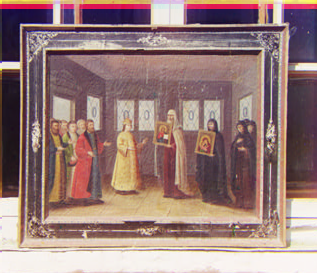

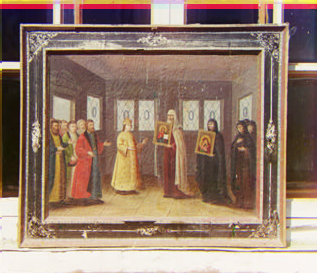

In [24]:
#image 6
img_06 = Image.fromarray(edge_aligned_images[5], 'RGB')
display(img_06)
autocontrast(edge_aligned_images[5])

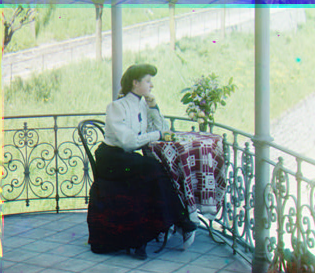

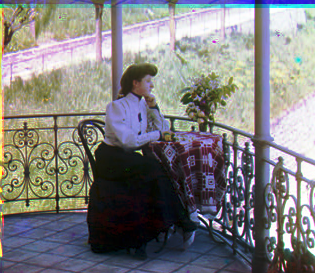

In [25]:
#image 9
img_09 = Image.fromarray(edge_aligned_images[8], 'RGB')
display(img_09)
equalize(edge_aligned_images[8])

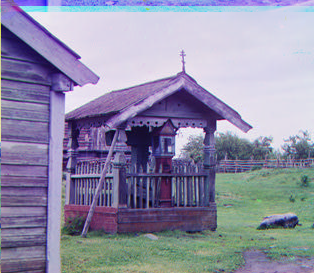

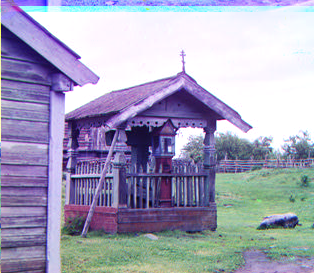

In [26]:
#image 15
img_15 = Image.fromarray(edge_aligned_images[14], 'RGB')
display(img_15)

gamma(edge_aligned_images[14],0.67)


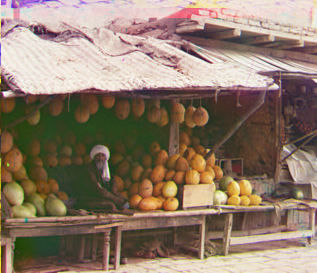

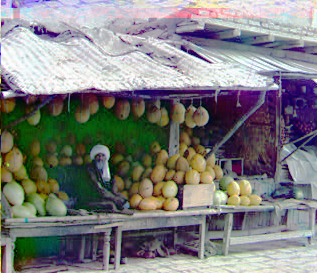

In [27]:
#image 26
img_26 = Image.fromarray(edge_aligned_images[25], 'RGB')
display(img_26)

equalize(edge_aligned_images[25])

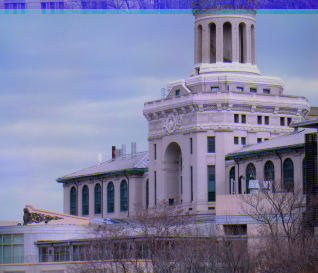

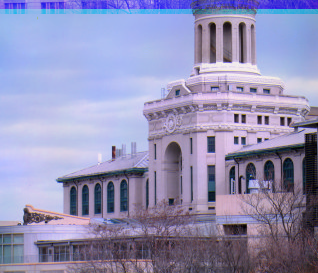

In [28]:
#image 29
img_29 = Image.fromarray(edge_aligned_images[28], 'RGB')
display(img_29)

autocontrast(edge_aligned_images[28])